<a href="https://colab.research.google.com/github/ccar9636-crypto/ProyectoI_MIIA_2025/blob/main/Python/S3_01_Arboles_Churn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Árboles de decisión: Churn compañía de servicios de telefonía móvil
## Cambio de prueba en Colab & GitHub

Vamos a aplicar un modelo de clasificación de árboles de decisión a un dataset que describe los clientes de una compañía que presta servicios de telefonía móvil que se han abandonado o no la compañía para irse a la competencia.

Importamos las librerías que vamos a utilizar

In [ ]:
import numpy as np #operaciones matriciales y con vectores
import pandas as pd #tratamiento de datos
import matplotlib.pyplot as plt #gráficos
from sklearn import tree, datasets, metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
#from sklearn import neighbors, datasets, metrics
from sklearn.model_selection import train_test_split #metodo de particionamiento de datasets para evaluación
from sklearn.model_selection import cross_val_score, cross_validate #método para evaluar varios particionamientos de C-V
from sklearn.model_selection import KFold, StratifiedKFold, RepeatedKFold, LeaveOneOut #Iteradores de C-V
import seaborn as sns
import math

import warnings
warnings.filterwarnings('ignore')

## Entendimiento de los datos

Cargamos los datos para entenderlos

In [ ]:
data = pd.read_csv('02-churn.csv', sep=';', na_values=".")
print(data.shape)
data.head(5)

(20000, 12)


,COLLEGE,INCOME,OVERAGE,LEFTOVER,HOUSE,HANDSET_PRICE,OVER_15MINS_CALLS_PER_MONTH,AVERAGE_CALL_DURATION,REPORTED_SATISFACTION,REPORTED_USAGE_LEVEL,CONSIDERING_CHANGE_OF_PLAN,LEAVE
0,zero,31953,0,6,313378,161,0,4,unsat,little,no,STAY
1,one,36147,0,13,800586,244,0,6,unsat,little,considering,STAY
2,one,27273,230,0,305049,201,16,15,unsat,very_little,perhaps,STAY
3,zero,120070,38,33,788235,780,3,2,unsat,very_high,considering,LEAVE
4,one,29215,208,85,224784,241,21,1,very_unsat,little,never_thought,STAY


**Parte 1**:
* Determine el número de registros, de variables, sus tipos ideales/reales, y sus rangos
* Determine el baseline y su accuracy. ¿Están balanceados los datos?
* ¿Encuentran algún problema con los datos (missing values, datos inválidos, etc.)?
* Si fuésemos a utilizar K-NN, ¿debería hacerse algún pretratamiento de los datos?

El método **describe** permite obtener un dataframe con una descripción de las variables de un dataframe analizado. Para cada variable encontramos el número de registros validos (*count*).

Además, si se trata de una variable categórica, se puede obtener el número de clases posibles (*unique*), la clase mayoritaria (*top*) y la frecuencia de la clase mayoritaria (*freq*).

Y, si se trata de una variable numérica, se puede obtener el promedio (*mean*), desviación estándar (*std*), los valores mínimos (*min*) y máximos (*max*) y los cuartiles (*25%*, *50%* y *75%*).

In [ ]:
data.describe(include="all")

,COLLEGE,INCOME,OVERAGE,LEFTOVER,HOUSE,HANDSET_PRICE,OVER_15MINS_CALLS_PER_MONTH,AVERAGE_CALL_DURATION,REPORTED_SATISFACTION,REPORTED_USAGE_LEVEL,CONSIDERING_CHANGE_OF_PLAN,LEAVE
count,20000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000,20000,20000,20000
unique,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,5,5,2
top,one,NaN,NaN,NaN,NaN,NaN,NaN,NaN,very_unsat,little,considering,STAY
freq,10048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7909,7875,7920,10148
mean,NaN,80281.447750,85.979550,23.898650,493155.264250,389.615100,8.000700,6.002250,NaN,NaN,NaN,NaN
std,NaN,41680.586319,85.992324,26.816645,252407.884692,213.820682,8.925418,4.402558,NaN,NaN,NaN,NaN
min,NaN,20007.000000,-2.000000,0.000000,150002.000000,130.000000,0.000000,1.000000,NaN,NaN,NaN,NaN
25%,NaN,42217.000000,0.000000,0.000000,263714.250000,219.000000,1.000000,2.000000,NaN,NaN,NaN,NaN
50%,NaN,75366.500000,59.000000,14.000000,452259.500000,326.000000,4.000000,5.000000,NaN,NaN,NaN,NaN
75%,NaN,115881.750000,179.000000,41.000000,702378.000000,533.250000,15.000000,10.000000,NaN,NaN,NaN,NaN


In [ ]:
data.LEAVE.describe()

count     20000
unique        2
top        STAY
freq      10148
Name: LEAVE, dtype: object

In [ ]:
data.LEAVE.describe()['freq'] / data.LEAVE.describe()['count']

0.5074

In [ ]:
data.LEAVE.value_counts()

LEAVE
STAY     10148
LEAVE     9852
Name: count, dtype: int64

<Axes: xlabel='LEAVE'>

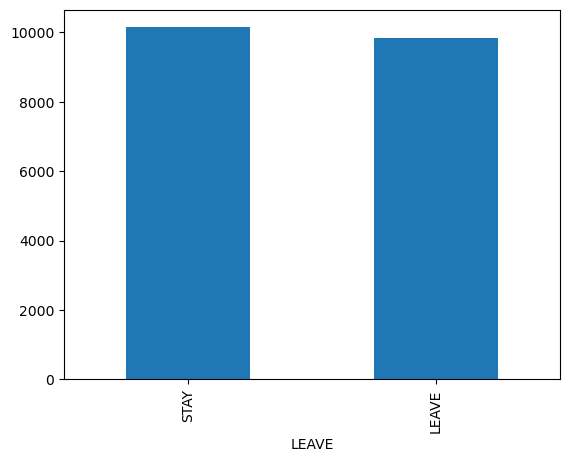

In [ ]:
data.LEAVE.value_counts().plot.bar()

**Parte 2**:

Utilizando pandas y matplotlib, analice la distribución de las variables independientes con respecto a los valores de la variable objetivo LEAVE y STAY. Trate de encontrar patrones en plots univariados (densidad) y Bivariados (scatterplots) para las variables numéricas, y gráficos de barras de conteo para las categóricas.

In [ ]:
var_indep_cat = ['COLLEGE', 'REPORTED_SATISFACTION', 'REPORTED_USAGE_LEVEL',
       'CONSIDERING_CHANGE_OF_PLAN', 'LEAVE']

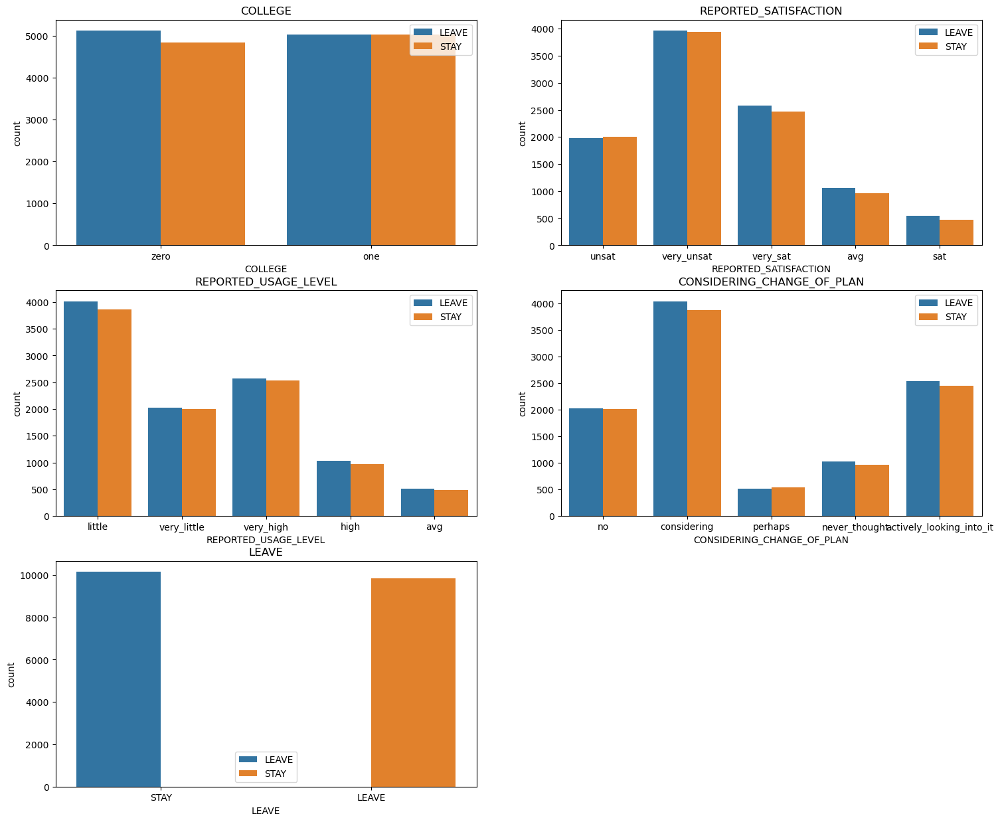

In [ ]:
fig = plt.figure(figsize=(18,15))
i=1
for var_cat in var_indep_cat:
    ax = fig.add_subplot(math.ceil(len(var_indep_cat)/2), 2, i)
    sns.countplot(x=var_cat, hue="LEAVE", data=data)
    plt.title(var_cat)
    plt.legend(['LEAVE', 'STAY'])
    i+=1


In [ ]:
var_indep_cat.remove('LEAVE')

In [ ]:
var_indep_num = ['INCOME', 'OVERAGE', 'LEFTOVER', 'HOUSE', 'HANDSET_PRICE',
                 'OVER_15MINS_CALLS_PER_MONTH', 'AVERAGE_CALL_DURATION']

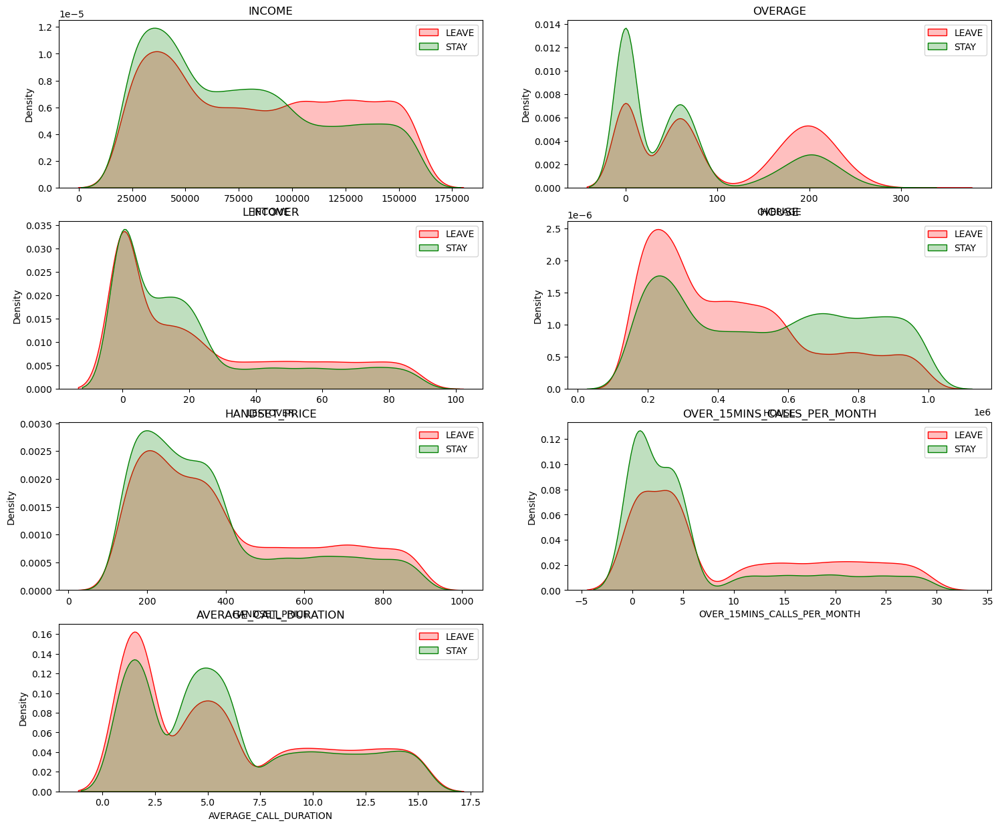

In [ ]:
fig = plt.figure(figsize=(18,15))
i=1
for var_num in var_indep_num:
    ax = fig.add_subplot(math.ceil(len(var_indep_num)/2), 2, i)
    sns.kdeplot(data[data['LEAVE']=='LEAVE'][var_num], shade=True, color='r', ax=ax);
    sns.kdeplot(data[data['LEAVE']=='STAY'][var_num], shade=True, color='g', ax=ax);
    plt.title(var_num)
    plt.legend(['LEAVE', 'STAY'])
    i+=1

# Clasificación a partir un árbol de decisión

Los árboles de decisión permiten utilizar tanto las variables predictivas categóricas como las numéricas.
No todas las variables van a ser útiles. El árbol se va a encargar de encontrar la mejor variable a utilizar en el contexto del subconjunto de datos de cada rama.

Veamos cómo se crea un árbol de decisión en scikit-learn, y algunos de los parámetros más importantes:

In [ ]:
np.random.seed(1234)
ctree = tree.DecisionTreeClassifier( #CART
    criterion='entropy', # el criterio de particionamiento de un conjunto de datos (gini, entropy)
    max_depth=None,      # prepoda: controla la profundidad del árbol (largo máximo de las ramas)
    min_samples_split=2, # prepoda: el mínimo número de registros necesarios para crear una nueva rama
    min_samples_leaf=1,  # prepoda: el mínimo número de registros en una hoja
    random_state=None,   # semilla del generador aleatorio utilizado para
    max_leaf_nodes=None, # prepoda: máximo número de nodos hojas
    min_impurity_decrease=0.0, # prepoda: umbral mínimo de reducción de la impureza para aceptar la creación de una rama
    class_weight=None    # permite asociar pesos a las clases, en el caso de diferencias de importancia entre ellas
)

**Nota editorial**: Anteriormente scikit-learn (versión < 1.2) soportaba en sus árboles de decisión solamente variables independientes numéricas!!!!! Era necesario entonces utilizar un encoding (one hot) u ordinal encoding.

In [ ]:
#data_cat_one_hot = pd.get_dummies(data[var_indep_cat], prefix=var_indep_cat)
# ✅ Convert all categorical columns to category codes
for col in var_indep_cat:
    data[col] = data[col].astype("category").cat.codes

X = data[var_indep_num].join(data[var_indep_cat])
y = data['LEAVE']
X.shape

(20000, 11)

In [ ]:
np.random.seed(1234)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

clf = DecisionTreeClassifier(random_state=42)
clf.fit(X, data['LEAVE'])


DecisionTreeClassifier(random_state=42)

In [ ]:
ctree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy')

Una vez el árbol es aprendido, se puede consultar diferentes atributos.
El mas interesante, aparte del árbol en sí, es el que asocia un índice de importancia a los atributos independientes en la clasificación:

In [ ]:
ctree.feature_importances_

array([0.19504929, 0.15763843, 0.09153985, 0.19037917, 0.1398906 ,
       0.05708158, 0.04195001, 0.01949471, 0.03436923, 0.03302725,
       0.03957989])

In [ ]:
X.columns

Index(['INCOME', 'OVERAGE', 'LEFTOVER', 'HOUSE', 'HANDSET_PRICE',
       'OVER_15MINS_CALLS_PER_MONTH', 'AVERAGE_CALL_DURATION', 'COLLEGE',
       'REPORTED_SATISFACTION', 'REPORTED_USAGE_LEVEL',
       'CONSIDERING_CHANGE_OF_PLAN'],
      dtype='object')

Encontramos entonces que las variables en orden de importancia son:

In [ ]:
X.columns[np.argsort(-ctree.feature_importances_)]

Index(['INCOME', 'HOUSE', 'OVERAGE', 'HANDSET_PRICE', 'LEFTOVER',
       'OVER_15MINS_CALLS_PER_MONTH', 'AVERAGE_CALL_DURATION',
       'CONSIDERING_CHANGE_OF_PLAN', 'REPORTED_SATISFACTION',
       'REPORTED_USAGE_LEVEL', 'COLLEGE'],
      dtype='object')

Vamos ahora a visualizar el árbol aprendido (para hacerlo, se necesita preinstalar la aplicación graphviz).

In [ ]:
import pydotplus
from IPython.display import Image
from six import StringIO

In [ ]:
dot_data = StringIO()
tree.export_graphviz(ctree,
                     filled=True, rounded=True,  #nodos redondeados y coloreados
                     class_names=ctree.classes_,
                     feature_names=X_train.columns,
                     out_file=dot_data,
                     special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.316938 to fit



La imágen es demasiado grande para poder visualizarla aquí, vamos a guardarla un archivo y abrirla en un visor externo que permita hacer zoom.

In [ ]:
# Create PNG
graph.write_png("arbol.png")

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.316938 to fit



True

Como se puede ver el árbol es increiblemente grande y complejo, pues no se especificó ninguna manera de limitar su crecimiento.

## Evaluación del modelo

Ya tenemos el modelo "aprendido" con el dataset de 20000 instancias.
Vamos ahora a evaluarlo sobre ese mismo dataset para poder ver los aciertos y errores en la predicción.

In [ ]:
y_pred = ctree.predict(X_test)

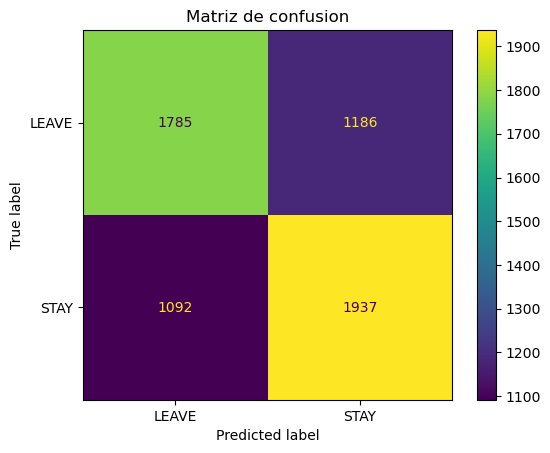

In [ ]:
cm = confusion_matrix(y_test, y_pred, labels=ctree.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=ctree.classes_)
disp.plot()
plt.title("Matriz de confusion")
plt.show()

In [ ]:
print(cm)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))
print("Kappa    : ", metrics.cohen_kappa_score(y_test, y_pred))
print("Precisión     : ", metrics.precision_score(y_test, y_pred, labels=ctree.classes_ , average='macro'))
print("Recall        : ", metrics.recall_score(y_test, y_pred, labels=ctree.classes_, average='macro'))
VN = np.sum(cm[1:3,1:3])
FP = np.sum(cm[0,1:3])
specificity = VN/(VN+FP)
print("Especificidad : ", specificity)
print("F1-score      : ", metrics.f1_score(y_test, y_pred,labels=ctree.classes_, average='macro'))


[[1785 1186]
 [1092 1937]]
Exactitud:  0.6203333333333333
Kappa    :  0.24036559823209935
Precisión     :  0.6203374539267175
Recall        :  0.6201463936796761
Especificidad :  0.6202369516490553
F1-score      :  0.620089515226661


Con el árbol completo, obtuvimos un nivel de accuracy del 61.68%, cuando el baseline era de 50.74%.

## Overfitting: poda del árbol

Analizaremos ahora el comportamiento de las predicciones si limitamos el crecimiento del árbol (prepoda), controlando la profundidad del árbol y el mínimo número de registros de un nodo para permitir el particionamiento.

**Parte 3**:

Modifiquen el parámetro **criterion** y los parámetros de pre-poda buscando una mejor exactitud del modelo:
- **max_depth**: entre mas grande el valor, el árbol será más complejo (más número de niveles de profundidad)
- **min_samples_split**: entre mas grande el valor, el árbol será más sencillo (se necesita tener más registros en un nodo para poder particionarlo)
- **min_samples_leaf**: entre mas grande el valor, el árbol será más sencillo (se necesita tener más registros en una hoja para poder aceptarla, si no se llega a esa cardinalidad, no se permite el partionamiento de su nodo padre)
- **min_impurity_decrease**: entre mas grande el valor, el árbol será más sencillo (un nivel de impureza inferior a este umbral no permitirá un particionamiento).


In [ ]:
np.random.seed(1234)
ctree = tree.DecisionTreeClassifier(
    criterion='entropy', # el criterio de particionamiento de un conjunto de datos
#    max_depth=,      # prepoda: controla la profundidad del árbol (largo máximo de las ramas)
#    min_samples_split=, # prepoda: el mínimo número de registros necesarios para crear una nueva rama
#    min_samples_leaf=,  # prepoda: el mínimo número de registros en una hoja
    random_state=None,   # semilla del generador aleatorio utilizado para
#    max_leaf_nodes=, # prepoda: máximo número de nodos hojas
    min_impurity_decrease=0.0, # prepoda: umbral mínimo de reducción de la impureza para aceptar la creación de una rama
    class_weight=None    # permite asociar pesos a las clases, en el caso de diferencias de importancia entre ellas
)
ctree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy')

In [ ]:
y_pred = ctree.predict(X_test)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))

Exactitud:  0.6236666666666667


In [ ]:
dot_data = StringIO()
tree.export_graphviz(ctree,
                     filled=True, rounded=True,  #nodos redondeados y coloreados
                     class_names=ctree.classes_,
                     feature_names=X_train.columns,
                     out_file=dot_data,
                     special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.314191 to fit



Podríamos seguir mejorando el árbol optimizando los parámetros de la prepoda. ¿Cómo?

Podemos intentar con otro tipo de modelos, e.g KNN.

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
np.random.seed(1234)
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)
cm= metrics.confusion_matrix(y_test, y_pred)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))
print("Kappa    : ", metrics.cohen_kappa_score(y_test, y_pred))

Exactitud:  0.5756666666666667
Kappa    :  0.15131419075341357


## Modelos de ensamble: bagging, random forest, boosting

## Bagging

Vamos ahora a crear un modelo de ensamble que utiliza muchos modelos de árboles sencillos que pone a votar para encontrar una decisión consensuada.

In [ ]:
from sklearn.ensemble import BaggingClassifier
np.random.seed(1234)
ctree = tree.DecisionTreeClassifier(
    criterion='entropy', # el criterio de particionamiento de un conjunto de datos
    max_depth=7,      # prepoda: controla la profundidad del árbol (largo máximo de las ramas)
    min_samples_split=1000, # prepoda: el mínimo número de registros necesarios para crear una nueva rama
    min_samples_leaf=1,  # prepoda: el mínimo número de registros en una hoja
    random_state=None,   # semilla del generador aleatorio utilizado para
    max_leaf_nodes=None, # prepoda: máximo número de nodos hojas
    min_impurity_decrease=0.0, # prepoda: umbral mínimo de reducción de la impureza para aceptar la creación de una rama
    class_weight=None    # permite asociar pesos a las clases, en el caso de diferencias de importancia entre ellas
)
bagging = BaggingClassifier(estimator = ctree,   # Por defecto un decision tree
                            n_estimators=200,          # Número de modelos a crear
                            max_samples=0.7,          # Número o % de registros de la muestra de aprendizaje
                            max_features=0.7,         # Número o % de atributos de la muestra de aprendizaje
                            bootstrap=True,           # Utilizar reemplazo en el muestreo de los registros de aprendizaje
                            bootstrap_features=False, # Utilizar reemplazo en el muestreo de los atributos de aprendizaje
                            oob_score=False,          # Evaluar cada modelo con los registros no utilizados en su aprendizaje
                            n_jobs=2,                 # Número de cores a utilizar
                            random_state=None,        # random seed para el generador aleatorio
                            verbose=0)                # controla la cantidad de información a reportar


In [ ]:
bagging.fit(X_train, y_train)
y_pred = bagging.predict(X_test)
cm= metrics.confusion_matrix(y_test, y_pred)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))
print("Kappa    : ", metrics.cohen_kappa_score(y_test, y_pred))

Exactitud:  0.702
Kappa    :  0.4043243784690137


Podemos hacer bagging de otro tipo de estimadores de base, por ejemplo KNN.

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
np.random.seed(1234)
bagging = BaggingClassifier(estimator = KNeighborsClassifier(),   # Por defecto un decision tree
                            n_estimators=50,          # Número de modelos a crear
                            max_samples=0.5,          # Número o % de registros de la muestra de aprendizaje
                            max_features=0.5,         # Número o % de atributos de la muestra de aprendizaje
                            bootstrap=True,           # Utilizar reemplazo en el muestreo de los registros de aprendizaje
                            bootstrap_features=False, # Utilizar reemplazo en el muestreo de los atributos de aprendizaje
                            oob_score=False,          # Evaluar cada modelo con los registros no utilizados en su aprendizaje
                            n_jobs=2,                 # Número de cores a utilizar
                            random_state=None,        # random seed para el generador aleatorio
                            verbose=0)                # controla la cantidad de información a reportar

bagging.fit(X_train, y_train)
y_pred = bagging.predict(X_test)
cm= metrics.confusion_matrix(y_test, y_pred)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))
print("Kappa    : ", metrics.cohen_kappa_score(y_test, y_pred))

Exactitud:  0.6526666666666666
Kappa    :  0.30517437267036973


## Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
np.random.seed(1234)
rforest = RandomForestClassifier(n_estimators=100,     #Número de modelos a crear
                                criterion='entropy', # el criterio de particionamiento de un conjunto de datos
                                max_depth=6,      # prepoda: controla la profundidad del árbol (largo máximo de las ramas)
                                min_samples_split=1000, # prepoda: el mínimo número de registros necesarios para crear una nueva rama
                                min_samples_leaf=1,  # prepoda: el mínimo número de registros en una hoja
                                max_features='sqrt', # Número o % de atributos de la muestra de aprendizaje
                                max_leaf_nodes=None, # prepoda: máximo número de nodos hojas
                                min_impurity_decrease=0.0, # prepoda: umbral mínimo de reducción de la impureza para aceptar la creación de una rama
                                bootstrap=True,      # Utilizar reemplazo en el muestreo de los registros de aprendizaje
                                oob_score=True,     # Evaluar cada modelo con los registros no utilizados en su aprendizaje
                                n_jobs=2,            # Número de cores a utilizar
                                random_state=None,   # random seed para el generador aleatorio
                                verbose=0)           # controla la cantidad de información a reportar
rforest.fit(X_train, y_train)
y_pred = rforest.predict(X_test)
cm= metrics.confusion_matrix(y_test, y_pred)
print("Exactitud: ", metrics.accuracy_score(y_test, y_pred))
print("Kappa    : ", metrics.cohen_kappa_score(y_test, y_pred))

Exactitud:  0.6968333333333333
Kappa    :  0.39300558230196936


In [ ]:
rforest.oob_score_

0.6921428571428572

Encontramos que las variables en orden de importancia son:

In [ ]:
X.columns[np.argsort(-rforest.feature_importances_)]

## Boosting

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import zero_one_loss
np.random.seed(1234)

numModelos = 400
ada_10 = AdaBoostClassifier(estimator=None,  #Por defecto se trata de decision stumps
                         n_estimators=numModelos,     #Número de modelos a crear
                         algorithm='SAMME',
                         learning_rate=1.0)    #Reduce la importancia de los modelos mas recientes
ada_10.fit(X_train, y_train)
ada_02 = AdaBoostClassifier(estimator=None,  #Por defecto se trata de decision stumps
                         n_estimators=numModelos,     #Número de modelos a crear
                        algorithm='SAMME',
                         learning_rate=0.2)    #Reduce la importancia de los modelos mas recientes

ada_02.fit(X_train, y_train)
ada_005 = AdaBoostClassifier(estimator=None,  #Por defecto se trata de decision stumps
                         n_estimators=numModelos,     #Número de modelos a crear
                         algorithm='SAMME',
                         learning_rate=0.05)    #Reduce la importancia de los modelos mas recientes
ada_005.fit(X_train, y_train)

AdaBoostClassifier(algorithm='SAMME', learning_rate=0.05, n_estimators=400)

In [ ]:
ada_errores_test_10 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_10.staged_predict(X_test)):
    ada_errores_test_10[i] = 1-zero_one_loss(y_pred, y_test)
ada_errores_train_10 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_10.staged_predict(X_train)):
    ada_errores_train_10[i] = 1-zero_one_loss(y_pred, y_train)

In [ ]:
ada_errores_test_02 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_02.staged_predict(X_test)):
    ada_errores_test_02[i] = 1-zero_one_loss(y_pred, y_test)
ada_errores_train_02 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_02.staged_predict(X_train)):
    ada_errores_train_02[i] = 1-zero_one_loss(y_pred, y_train)

In [ ]:
ada_errores_test_005 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_005.staged_predict(X_test)):
    ada_errores_test_005[i] = 1-zero_one_loss(y_pred, y_test)

ada_errores_train_005 = np.zeros((numModelos,))
for i, y_pred in enumerate(ada_005.staged_predict(X_train)):
    ada_errores_train_005[i] = 1-zero_one_loss(y_pred, y_train)

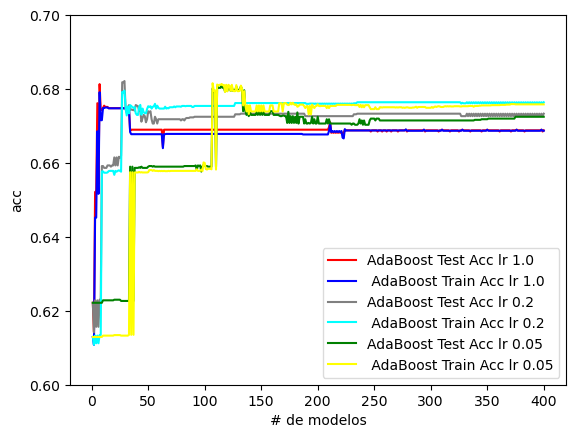

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111)

ax.plot(np.arange(numModelos) + 1, ada_errores_test_10,
        label='AdaBoost Test Acc lr 1.0',
        color='red')
ax.plot(np.arange(numModelos) + 1, ada_errores_train_10,
        label=' AdaBoost Train Acc lr 1.0',
        color='blue')
ax.plot(np.arange(numModelos) + 1, ada_errores_test_02,
        label='AdaBoost Test Acc lr 0.2',
        color='gray')
ax.plot(np.arange(numModelos) + 1, ada_errores_train_02,
        label=' AdaBoost Train Acc lr 0.2',
        color='cyan')
ax.plot(np.arange(numModelos) + 1, ada_errores_test_005,
        label='AdaBoost Test Acc lr 0.05',
        color='green')
ax.plot(np.arange(numModelos) + 1, ada_errores_train_005,
        label=' AdaBoost Train Acc lr 0.05',
        color='yellow')

ax.set_ylim((0.6, 0.7))
ax.set_xlabel('# de modelos')
ax.set_ylabel('acc')

leg = ax.legend(loc='lower right', fancybox=True)
leg.get_frame().set_alpha(0.7)

plt.show()

**Ejercicio.** De acuerdo a la gráfica realice observaciones del comportamiento de los modelos.